# Análisis de Asociación de Variables Aleatorias

En esta sección, se presentan tests para analizar la asociación entre variables aleatorias continuas (ANOVA), o la asociación entre variables aleatorias discretas o categóricas (Chi-cuadrado, Bowker).

### ¿Por qué ANOVA?

En los test de hipótesis estudiados en sesiones anteriores, consideramos el uso de la distribución $t$- student para analizar las medias muestrales.
En lo que sigue utilizaremos el **Análisis de la Varianza** (ANOVA) o también llamado **análisis de factores**, para estudiar el efecto de uno o más factores (cada uno con dos o más niveles) sobre la media de una variable continua.

**Test de medias para dos poblaciones normales con la misma varianza desconocida (caso común)**

Sean $X_1,\cdots,X_n$ e $Y_1,\cdots,Y_m$ muestras independientes de poblaciones normales con medias desconocidas $\mu_x$ y $\mu_y$ y misma varianza desconocida $\sigma^2$.
Consideremos el test de hipótesis:

$$H_0: \mu_x = \mu_y$$

$$H_1: \mu_x \neq \mu_y$$

del Corolario del Teo de Fisher-Cochran se cumple:

$$ \frac{\bar{X} - \bar{Y} - (\mu_x - \mu_y)}{\sqrt{S_p^2(\frac{1}{n}+ \frac{1}{m})}} \sim t_{n+m-2}$$

donde

$$S_p^2 = \frac{(n-1)S_X^2 + (m-1)S_Y^2}{n+m-2}$$

de manera que se rechaza $H_0$ si

$$\frac{\bar{X} - \bar{Y}}{\sqrt{S_p^2(\frac{1}{n}+ \frac{1}{m})}} >  t_{\frac{\alpha}{2},n+m-2}$$


En el caso en que se requiera comparar más de 2 grupos, o examinar el efecto de 1, 2 o mas factores, este procedimiento se vuelve ineficiente, porque no queremos hacer un montón de t-tests para cada par.  

Además, **family-wise error rate** (la tasa de error de la familia, error global) que es la probabilidad de cometer al menos un error de Tipo I en múltiples pruebas estadísticas realizadas en los mismos datos **aumenta**. Para $c$ tests se calcula como:

$$\bar{\alpha} = 1-(1-\alpha)^c$$

- con c=2 tests, el error de tipo I es 0.0975 (alrededor de 2*0.05=0.1)
- con c=3 tests, el error de tipo I es 0.143 (alrededor de 3*0.05=0.15)
- con c=10 tests, el error de tipo I es 0.40 (alrededor de 10*0.05=0.5)

Por lo tanto, es mejor abordar con el modelo del **Análisis de la Varianza (ANOVA)**.

### Repaso
#### La distribución chi-cuadrado

Sean $Z_1,\cdots, Z_n\, v.a. i.i.d. \, \sim {\it N}(0,1)$ entonces 

$$ Y = Z_1^2+\cdots+Z_n^2 \sim \chi_{n}^2$$

donde $n$ son los grados de libertad de la distribución.

Propiedades de la distribución $\chi^2$:

(i) Propiedad aditiva: si $X_1$ y $X_2$ son dos v.a. independientes distribuidas $\chi^2$ de $n_1$ y $n_2$ grados de libertad, entonces

$$X_1+X_2 \sim \chi_{n_1+n_2}^2$$

(ii) Esperanza y Varianza:

$$ E[X]= n,  \qquad Var[X]= 2n$$




In [1]:
suppressMessages(library(dplyr))
suppressMessages(library(plotly))
suppressMessages(library(ggplot2))
suppressMessages(library(rmarkdown))
vec <- seq(0,100,by=0.1)
params <- c(1:5, seq(10, 100, by=10)) 
pvec <- list()
for (i in 1:length(params)){
    pvec[[i]] <- dchisq(vec,df=params[i],ncp=0)
}
steps <- list()
fig <- plot_ly(width=600,height=600) %>% layout(title = "\n \n Densidad de Probabilidad Chi-cuadrado", yaxis = list(range=c(0,0.3)))
for (i in 1:length(params)){
    fig <- add_lines(fig, x=vec, y=pvec[[i]], visible=if (i==1) TRUE else FALSE, mode='lines', line=list(color='blue'), showlegend=FALSE)
    steps[[i]] = list(args = list('visible', rep(FALSE, length(params))), label=params[i], method='restyle')
    steps[[i]]$args[[2]][i] = TRUE
}
fig <- fig %>% layout(sliders = list(list(active=0, currentvalue = list(prefix = "df: "), steps=steps)))
fig

HTML widgets cannot be represented in plain text (need html)

#### La distribución F

Sean $X \sim \chi_n^2$ e $Y \sim \chi_m^2$  dos v.a. independientes $\chi^2$ de grados de libertad $n$ y $m$ respectivamente, entoncese se define:

$$F = \frac{\frac{X}{n}}{\frac{Y}{m}} \sim F_{n,m}$$

donde $F_{n,m}$ es la distribución $F$ de $n$ y $m$ grados de libertad.
También se nota $F(n,m)$.


In [2]:
vec <- seq(0,5,by=0.01)
params <- seq(1,20,by=1)
pvec <- list()
for (i in 1:length(params))
    for (j in 1:length(params)){
        k = length(params)*(i-1) + j
        pvec[[k]] <- df(vec,df1=params[i],df2=params[j],ncp=0)
}


In [4]:
steps1 <- list()
steps2 <- list()
fig <- plot_ly(width=600,height=600) %>% layout(title = "\n \n Densidad de Probabilidad F(n, m)",
                                                 yaxis = list(range=c(0,1)))
for (i in 1:length(params)){
     for (j in 1:length(params)){
        k = length(params)*(i-1) + j
        fig <- add_lines(fig, x=vec, y=pvec[[k]], 
                     visible=if ((i==1) && (j==1)) TRUE else FALSE,
                     mode='lines', line=list(color='blue'), showlegend=FALSE)
        steps2[[j]] = list(args = list('visible', rep(FALSE, length(params)*length(params))), 
                      label=params[j], method='restyle')
        steps2[[j]]$args[[2]][k] = TRUE
        steps1[[i]] = list(args = list('visible', rep(FALSE, length(params)*length(params))), 
                      label=params[i], method='restyle')
        steps1[[i]]$args[[2]][k] = TRUE
  }                   
}
fig <- fig %>% layout(sliders = 
                      list( list(active=0, currentvalue = list(prefix = "df1 (n): "), pad = list(t=20), steps=steps1),
                      list(active=0, currentvalue = list(prefix = "df2 (m): "), pad = list(t=100), steps=steps2)))
fig

HTML widgets cannot be represented in plain text (need html)

**Percentil**

Sea $F_{\alpha,n,m}$ tal que $P\{F > F_{\alpha,n,m} \} = \alpha$, $F_{\alpha,n,m}$ es el percentil $100(1-\alpha)$ de la distribución $F_{n,m}$.


<img src="F_percentil.png" width="400">

**Relación entre las distribuciones F y t**

Si $X \sim t_{n}$ entonces $X^2 \sim F_{1,n}$. Por qué?

```{toggle}
Por construcción, si $X \sim t_{n}$, entonces 

$$X = \frac{Z}{\sqrt{\frac{Y}{n}}}, \qquad con \, Z \sim {\cal N}(0,1) \,e \,Y \sim \chi_n^2$$

Entonces

$$X^2 = \frac{\frac{Z^2}{1}}{\frac{Y}{n}}, \qquad con \, Z^2 \sim \chi_1^2 \,e \,Y \sim \chi_n^2$$
```

#### La distribución de la media y varianza muestral del caso Normal

**Teorema de Fisher-Cochran** 

Sean $X_1,\cdots,X_n$ v.a. i.i.d. ${\cal N}(\mu,\sigma^2)$ entonces la media y varianza muestral cumplen:

$\begin{equation}
\begin{array}{lcll} 
(i) & \bar{X} &\sim& {\cal N}(\mu, \frac{\sigma^2}{n})\\ \\
(ii) & {\displaystyle \frac{(n-1)S^2}{\sigma^2}}& \sim& \chi_{n-1}^2 \\ \\
(iii)& \bar{X} &{\mathrel \perp} & S^2 \quad \text{(independentes)}\\
\end{array}
\end{equation}$

$S^2$ es la **varianza muestral**:

$$S^2 = \frac{1}{n-1}\sum_{i=1}^n (X_i-\bar{X})^2 $$

Por qué en $ {\displaystyle \frac{(n-1)S^2}{\sigma^2}} \sim \chi_{n-1}^2$, el **grado de liberdad** es $n-1$?

### ANOVA unidireccional (ANOVA de un factor)

Suponga que tenemos $m$ tratamientos distintos, donde el resultado de aplicar el tratamiento $i$ a un individuo es una v.a. normal. Estamos interesados en probar la hipótesis de que todos los tratamientos tienen el mismo efecto. Para ello se aplica cada tratamiento a una muestra distinta de $n$ individuos y se analizan los resultados. 

Formalmente, sean $m$ muestras (grupos) independientes de tamaño $n$: 

$$X_{i1},\cdots,X_{in} \sim i.i.d. \,{\cal N}(\mu_i,\sigma^2), \qquad i=1,\cdots, m$$

donde $\mu_i$ y $\sigma^2$ son desconocidos. Estamos interesados en probar:

$$H_0: \mu_1 = \mu_2 =\cdots =\mu_m\qquad$$

$$H_1: \exists i,j \in \{1,\cdots m \},\,  \mu_i \neq \mu_j$$

#### Supuestos (y robustez)

Consideramos sus supuestos y robustez aquí:
- **Normalidad**: cada muestra (o v.a. $X_{ij}$) debe provenir de una distribución normal. Utilizar por ejemplo, test de Shapiro-Wilk. Utilizar Q-Q plot para descartar la presencia de outliers.
    - El ANOVA unidireccional se considera una prueba robusta contra el supuesto de normalidad, cuando el tamaño de cada muestra (o grupo) no es pequeño (y los tamaños de grupos son iguales); si no, consideremos test nonparamétrico como Kruskal-Wallis H Test. 
- **Varianza común (homogeneidad)**: misma varianza en los grupos. Se puede probar la igualdad de varianzas con el test de Levene o con el test de Brown-Forsythe.
    - Si este supuesto falla, consideraremos test nonparamétrico como Kruskal-Wallis H Test.
- **Observaciones independientes**. Las poblaciones de los grupos son independientes y las observaciones de cada grupo son independientes. Este supuesto no puede ser probado con ningún estadístico, es una consideración de diseño 
    - La violación de esto es muy grave (por ejemplo, la tasa de error de Tipo I está sustancialmente inflada).

**Idea general de la derivación ANOVA**

Se trata de construir dos estimadores de la varianza común, el primer estimador no depende de si $H_0$ es cierto o no. En cambio, el segundo estimador asume que $H_0$ es cierto, en caso contrario este estimador sobreestima a $\sigma^2$.
El test compara ambos estimadores y rechaza $H_0$ cuando la tasa entre el segundo y primer estimador es suficientemente grande.

#### El primer estimador de $\sigma^2$ que no depende de $H_0$ ($SS_W$)
Definimos:

$$X_{i.} = \frac{\sum_{j=1}^n X_{ij}}{n}$$

Recordemos la propiedad:

$${\displaystyle \frac{(n-1)S^2}{\sigma^2}} \sim \chi_{n-1}^2$$

Así que:

$$ \sum_{j=1}^n \frac{(X_{ij} - X_{i.})^2}{\sigma^2} \sim \chi^2_{n-1} \quad \text{ (Por qué?)}$$

$$\sum_{i=1}^m \sum_{j=1}^n \frac{(X_{ij} -  X_{i.})^2}{\sigma^2} \sim \chi^2_{nm-m} \quad \text{ (Por qué?)}$$

Denominaremos 

$$ SS_W = \sum_{i=1}^m \sum_{j=1}^n (X_{ij} -  X_{i.})^2$$ 

($SS_W$ es "**w**ithin samples **s**um of **s**quares", o "residual sum of squares")

Entonces 

$$ \frac{E[SS_W]}{\sigma^2} = nm-m \quad \text{ (Por qué?)}$$

y luego

$$ \frac{E[SS_W]}{nm-m} = \sigma^2$$


con lo cual tenemos nuestro primer **estimador insesgado** (por qué insesgado?) de $\sigma^2$:

$$MSE = \frac{SS_W}{nm-m}$$

que se conoce como "error cuadrático medio" (**m**ean **s**quare **e**rror), "cuadrado de la media de los residuos" (residual mean square) o **"varianza intragrupos"** (within-group variance). Notar que no considera ningun supuesto sobre $H_0$.

#### El segundo estimador de $\sigma^2$ que depende de $H_0$ ($SS_B$)

En este caso suponemos que se cumple $H_0$, es decir

$$\mu = \mu_1 = \mu_2 = \cdots = \mu_m$$

De manera de que las medias muestrales cumplen:

$$X_{1.},X_{2.},\cdots,X_{m.} \sim i.i.d. \, {\cal N}\left(\mu, \frac{\sigma^2}{n} \right) \quad \text{ (Por qué?)}$$

entonces:

$$ \sum_{i=1}^m \frac{(X_{i.}-X_{..})^2}{\frac{\sigma^2}{n}} \sim \chi^2_{m-1} \quad \text{ (Por qué?)}$$

Denominaremos 

$$ SS_B = n\sum_{i=1}^m  (X_{i.} -  X_{..})^2 = \sum_{i=1}^m \sum_{i=1}^n (X_{i.} -  X_{..})^2$$

($SS_B$ es "**b**etween samples **s**um of **s**quares", o "model sum of squares".)

Entonces, si $H_0$ es cierto, se cumple 

$$ \frac{E[SS_B]}{\sigma^2} = m-1 \quad \text{ (Por qué?)}$$

y luego

$$ \frac{E[SS_B]}{m-1} = \sigma^2$$


con lo cual tenemos nuestro segundo **estimador insesgado** (por qué insesgado?) de $\sigma^2$:

$$MSB = \frac{SS_B}{m-1}$$

que se conoce como "cuadrado de la media entre muestras" (**b**etween samples **m**ean **s**quare), "cuadrado de la media del modelo" (model mean square) o **"varianza entregrupos"** (between-group variance).


#### Test estadístico

Se define como test estadístico (**T**est **S**tatistics):

$$TS = \frac{MSB}{MSE} = \frac{varianza \, entregrupos}{varianza \, intragrupos}$$

Cuándo rechazamos la hipótesis nula? 

```{toggle}
Se rechazará la hipótesis nula cuando TS sea suficientemente grande.
```

¿Cuál es la distribución de TS?

```{toggle}
$$ TS \sim F_{m-1,nm-m}$$

Demostración:

$$
TS = \frac{MSB}{MSE} = \frac{\frac{SS_B}{(m-1)}}{\frac{SS_W}{(nm-m)}}
 = \frac{\frac{1}{m-1}\sum_{i=1}^m \sum_{j=1}^n (X_{i.} -  X_{..})^2}{\frac{1}{nm-m}\sum_{i=1}^m \sum_{j=1}^n (X_{ij} -  X_{i.})^2} 
 = \frac{\frac{1}{(m-1)}\sum_{i=1}^m  \frac{(X_{i.} -  X_{..})^2}{\frac{\sigma^2}{n}}}{\frac{1}{(nm-m)}\sum_{i=1}^m \sum_{j=1}^n \frac{ (X_{ij} -  X_{i.})^2}{\sigma^2}}
$$

Sea entonces $F\sim F_{m-1,nm-m}$ y $F_{m-1,nm-m,\alpha}$ tal que:

$$P\{F > F_{m-1,nm-m,\alpha}\} = \alpha$$

Se calcula entonces el valor de $TS$, si $TS > F_{m-1,nm-m,\alpha}$ se rechaza $H_0$.

```
<!-- \begin{array}{lll}
TS & = & \frac{MSB}{MSE} = \frac{\frac{SS_b}{(m-1)}}{\frac{SS_W}{(nm-m)}}\\
&&\\
& = & \frac{\frac{n}{m-1}\sum_{i=1}^m  (X_{i.} -  X_{..})^2}{\frac{1}{nm-m}\sum_{i=1}^m \sum_{j=1}^n (X_{ij} -  X_{i.})^2} = 
\frac{\frac{1}{(m-1)}\sum_{i=1}^m  \frac{(X_{i.} -  X_{..})^2}{\sigma^2 /n}}{\frac{1}{(nm-m)}\sum_{i=1}^m \sum_{j=1}^n \frac{ (X_{ij} -  X_{i.})^2}{\sigma^2}}
\end{array} -->

#### Identidad de suma de cuadrados

Definimos $SS_{total} = SS_{T}$ (total sum of squares) como:

$$\sum_{i=1}^m \sum_{j=1}^n  (X_{ij} -  X_{..})^2$$

Cumple:

$$\sum_{i=1}^m \sum_{j=1}^n  (X_{ij} -  X_{..})^2 = 
\sum_{i=1}^m \sum_{j=1}^n  (X_{ij} -  X_{i.})^2 +
\sum_{i=1}^m \sum_{j=1}^n  (X_{i.} -  X_{..})^2 \quad \text{ (Por qué?)}$$

Así que tenemos:

$$SS_{total} = SS_{intragrupos} + SS_{entregrupos}$$ 

$$SS_{T} = SS_{W} + SS_{B}$$ 


#### Ejemplo (industria de automóviles)

Una industria de automóviles desea probar la calidad de 3 tipos de combustibles. Para ello observa el rendimiento (millas por 10 galones de combustible) de los 3 tipos de combustibles en 15 vehículos idénticos (5 con cada tipo de combustible). (Asumimos que los supuestos de ANOVA se mantienen aquí, pero hay que examinar los supuestos en tu análisis de los datos.)

Cuál es la hipótesis nula aquí?

Veamos primero la distribución de los datos:

In [3]:
library(tidyr)
library(ggplot2)
library(dplyr)
library(cowplot)

combustible,M,SD
<chr>,<dbl>,<dbl>
gas1,240.6,16.965
gas2,235.6,7.701
gas3,253.6,12.280


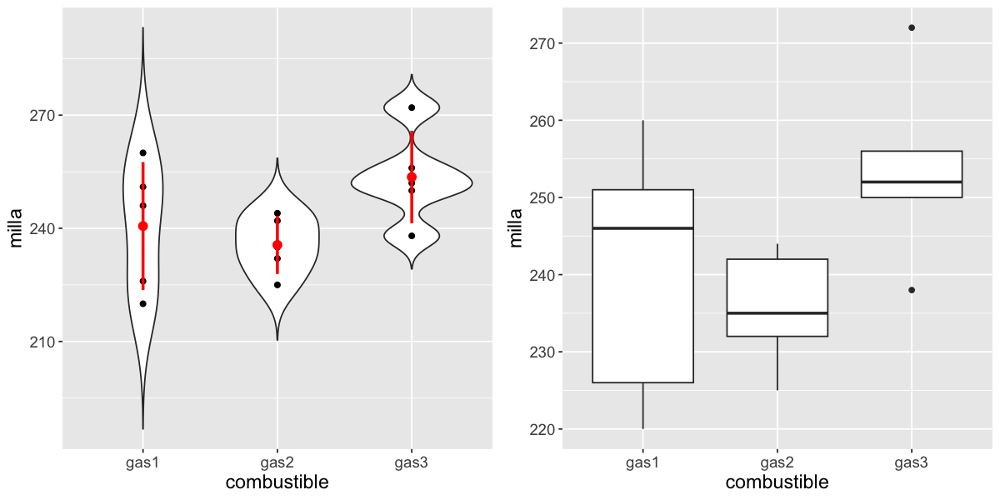

In [4]:
options(repr.plot.width=10, repr.plot.height=5)
options(digits=4)

gas1 <- c(220,251,226,246,260)
gas2 <- c(244,235,232,242,225)
gas3 <- c(252,272,250,238,256)

df <- do.call(rbind, Map(data.frame, gas1=gas1, gas2=gas2, gas3=gas3))
df <- df %>% pivot_longer(cols=c('gas1', 'gas2', 'gas3'),names_to='combustible', values_to='milla')
df %>% group_by(combustible) %>% summarise(M=mean(milla), SD=sd(milla))

#mean_sdl: computes the mean plus or minus a constant times the standard deviation. By default mult=2
p1 <- ggplot(df, aes(x=combustible, y=milla)) + 
    geom_violin(trim=FALSE) + 
    geom_dotplot(binaxis='y', stackdir='center', dotsize=1, binwidth=1.5) +
    stat_summary(fun.data=mean_sdl, fun.args=list(mult=1), geom="pointrange", color="red", lwd=1) + 
    theme(text=element_text(size=14))
p2 <- ggplot(df, aes(x=combustible, y=milla)) + geom_boxplot() + theme(text=element_text(size=14))

plot_grid(p1, p2, align="h", nrow=1, ncol=2, rel_widths= c(1/2, 1/2))

En tu tarea, tienes que desarrollar el test. Aquí, mostramos el resultado de R:

In [50]:
fm <- aov(milla ~ combustible, data=df)
summary(fm)

            Df Sum Sq Mean Sq F value Pr(>F)
combustible  2    863     432     2.6   0.12
Residuals   12   1992     166               

#### Caso de muestras con diferentes tamaños

¿Qué ocurre si las muestras no son del mismo tamaño?

$$\sum_{i=1}^m \sum_{j=1}^{n_i} \frac{(X_{ij} -  X_{i.})^2}{\sigma^2} \sim \chi^2_{N} \quad \text{ (Por qué?)}$$

donde $N = \sum_{i=1}^m n_i - m$. Y entonces,

$$ SS_W = \sum_{i=1}^m \sum_{j=1}^{n_i} (X_{ij} -  X_{i.})^2$$

por otra parte

$$\sum_{i=1}^m \frac{(X_{i.}-X_{..})^2}{\frac{\sigma^2}{n_i}} \sim \chi^2_{m-1}$$

y se definen

$$ SS_B = \sum_{i=1}^m n_i(X_{i.}-X_{..})^2 = \sum_{i=1}^m \sum_{j=1}^{n_i} (X_{i.}-X_{..})^2$$

$$ TS = \frac{\frac{SS_B}{m-1}}{\frac{SS_W}{N}} \sim F_{m-1,N} \qquad (N= \sum_{i=1}^m n_i - m)$$


Finalmente, si $TS > F_{\alpha,m-1,N}$ se rechaza $H_0$.


### Métodos de comparaciones múltiples
Si el test ANOVA es estadísticamente significativo, lo único que podemos concluir es que una o mas de las diferencias entre grupos es significativa, pero no sabemos que grupos son los que difirien. Para ello es necesario realizar "Comparaciones múltiples". Se trata de comparar cada grupo con otro grupo, o un promedio de grupos se puede comparar con otros. Se consideran dos posibilidades: 

- Comparaciones planeadas: existe interés por algunos grupos en particular
- **Comparaciones post hoc**: no existen hipótesis específicas de algunos grupos. Nos centramos en este caso aquí.

Aquí presentamos algunos métodos de comparaciones múltiples que son los más comúnmente usados.

#### Bonferroni
Utiliza el mismo estadístico que LSD, pero calcula la significancia $\alpha$ considerando que se realizan c comparaciones.

Dos posibilidades:

- Se calcula un nuevo valor de $\alpha$ para mantener el error de tipo I global:

$$ \alpha_{nuevo} = \frac{\alpha}{c} = \frac{\alpha}{\frac{m(m-1)}{2}}$$

  Por ejemplo, si $m=4, c=6$ y $\alpha=0.05$, entonces $\alpha_{nuevo} = 0.0083$

- Se corrige el p-value multiplicando por el número de comparaciones, y lo compara con el $\alpha$ original (e.g., 0.05):

$$p_{Bonferroni} = c* p_{LSD} = \frac{m(m-1)}{2} *p_{LSD}$$

Bonferroni puede ser demasiado conservador ($p_{Bonferroni}$ bastante grande, o $\alpha_{nuevo}$ bastante pequeño), lo que dificulta detectar diferencias que realmente existen (reduciendo su potencia). Pero puede garantizar el error de Tipo I, y es facíl entender la corrección. También lo usamos en comparaciones planeadas.

#### Tukey y Tukey-Kramer
**Tukey: mismo tamaño muestral n**

Se define el siguiente estadístico:

$$q_N =\frac{X_{i.} - X_{j.}}{\sqrt{\frac{MSE}{N}}}, \qquad df = N = \sum_{i=1}^m n_i-m$$

**Tukey-Kramer: distintos tamaños muestrales**

$$q_N = \frac{X_{i.} - X_{j.}}{\sqrt{MSE \left(\frac{\frac{1}{n_i}+ \frac{1}{n_j}}{2}\right)}}, \qquad df =N = \sum_{i=1}^m n_i - m$$

donde 

$$MSE = \frac{SS_W}{\sum_{i=1}^m n_i - m} = \frac{\sum_{i=1}^m \sum_{j=1}^{n_i} (X_{ij} -  X_{i.})^2}{\sum_{i=1}^m n_i - m}$$

En ambos casos $q_N$ sigue una distribución de **rangos student (studendized range distribution)** que es similar a t-student (studentized t-test) pero diferente. Usabmos el **$\alpha$ original** (e.g., 0.05). Segimos el proceso de de valor crítico o p-value.

El Tukey es menos conservador que Bonferroni. Tiene un control estricto sobre error de Tipo I (menos estricto que Bonferroni). Tiene buena potencia.

**Algunas preguntas**
> Si el test ANOVA es estadísticamente significativo, implica que ¿existe al menos un grupo cuyo comportamiento difiere de los otros?

No necesariamente, podría ocurrir que sea la combinación de grupos que provoque las diferencias.
El test de Scheffe permite pesquisar las diferencias subyacentes.

> ¿Es posible encontrar diferencias siginificativas con las comparaciones múltiples, aunque ANOVA no haya sido significativo?

Si, es posible, debido a que los tests de comparaciones múltiples están mas enfocados (tienen más potencia) que ANOVA.

> ¿Es útil el resultado del test ANOVA?

Claro, cuando corresponde a la hipótesis en estudio! 

A menudo, sus preguntas experimentales están más enfocadas en algunos grupos. En estos casos, puede saltar directamente a los tests de comparaciones múltiples (aunque algunas personas no están de acuerdo con esta afirmación). 

Pero tenga en cuenta que todos los cálculos de comparación múltiple utilizan MSE de la tabla ANOVA. 

## Análisis de asociación en v.a. discretas (o categóricas)
En esta sección se presentan algunos tests que permiten analizar la asociación entre variables aleatorias discretas.

### Tabla de contingencia
Consideremos que tenemos observaciones de dos variables discretas o categóricas (o bien variables continuas agrupadas en clases) $X$ y $Y$ referidas a una muestra. La tabla de contingencia contiene los efectivos correspondientes a cada pareja de valores (o clases) de ambas variables: 

$$\begin{array}{|c||c|c|c|c|c||c|}
\hline
\bf{X\mid Y}& \bf{d_1} &\cdots &\bf{d_k}& \cdots&\bf{d_s}& \text{total}\\
\hline\hline
\bf{c_1} & n_{11} & \cdots & n_{1k}& \cdots& n_{1s} &\bf { n_{1\bullet}}\\
\hline
\vdots & \vdots &&\vdots&&\vdots&\vdots\\
\hline
\bf{c_h} & n_{h1} & \cdots & n_{hk}& \cdots& n_{hs} & \bf{n_{h\bullet}}\\
\hline
\vdots & \vdots &&\vdots&&\vdots&\vdots\\
\hline
\bf{c_r} & n_{r1} & \cdots & n_{rk}& \cdots& n_{rs} & \bf{n_{r\bullet}}\\
\hline
\hline
\text{total} &\bf{n_{\bullet 1}}&\cdots& \bf{n_{\bullet k}}&\cdots&\bf{n_{\bullet s}}&\bf{n}\\ 
\hline \end{array}$$

Cada linea y cada columna corresponden  a una submuestra particular. La fila de índice $h$ es la distribución sobre  $ d_1,\ldots,d_s$ de los individuos para los cuales la variable $X$ toma el valor $c_h$. La columna de índice $k$ es la distribución sobre $c_1,\ldots,c_r$ de los  individuos para los cuales las variable $ Y$ toma el valor $d_k$. 

Los totales de renglones y columnas en la tabla $n_{h\bullet}, n_{\bullet k}$ (etc.) se denominan **frecuencias marginales**. 

Los valores en las celdas internas $n_{hk}$ (etc.) se denominan **frecuencias observadas**.

### Test de Chi-cuadrado de independencia para tablas de contingencia
Tenemos observaciones de dos variables discretas o categóricas (o bien variables continuas agrupadas en clases) $X$ y $Y$ referidas a una muestra de distribuciones desconocidas. Las observaciones de $X$ son independendes, y las observaciones de $Y$ son independendes. Nos interesa si $X$ y $Y$ son independientes. Tenemos las hipótesis: 

$$H_0: \forall h \in [1,r], k \in [1, s], \qquad P_{hk} = p_h q_k \\
H_1: \exists h \in [1,r], k \in [1, s], \qquad  P_{hk} \neq p_h q_k$$

donde 
- $P_{hk}$ se refiere a la probabilidad conjunta de que $X$ sea $c_h$ y $Y$ sea $d_k$
- $p_{h}$ se refiere a la probabilidad marginal de que $X$ sea $c_h$
- $q_{k}$ se refiere a la probabilidad marginal de que $Y$ sea $d_k$

Ya que no conocemos sus distribuciones, estimamos $P_{hk}, p_{h}, q_{k}$ a partir de la muestra, utilizando la tabla de contingencia: 

$$
\hat P_{hk} = \frac{n_{hk}}{n} \qquad
\hat p_{h} = \frac{n_{h \bullet}}{n} \qquad
\hat q_{k} = \frac{n_{\bullet k}}{n} 
$$

(Por qué podemos estimar así?)

Asi que bajo $H_0$, queremos que los valores de $\hat P_{hk}$ y $\hat p_{h} \hat q_{k}$ estén cercas: 

$$ \frac{n_{hk}}{n} \approx \frac{n_{h \bullet}}{n} \frac{n_{\bullet k}}{n} \qquad \Leftrightarrow \qquad  n_{hk} \approx \frac{n_{h \bullet} n_{\bullet k}}{n} $$

Recuerda que $n_{hk}$ es la **frecuencia observada** ($O_{hk}$), y aquí el producto $\displaystyle \frac{n_{h \bullet} n_{\bullet k}}{n}$ se denomina la **frecuencia esperada** ($E_{hk}$). Definimos un estadístico (v.a.) que representa la distancia entre ellos para todas combinaciones de valores:

$$TS = n \sum\limits_{k=1}^s \sum_{h=1}^r \frac{(\hat P_{hk} - \hat p_{h} \hat q_{k})^2}{\hat p_{h} \hat q_{k}} = \sum\limits_{k=1}^s \sum_{h=1}^r \frac{(O_{hk} - E_{hk})^2}{E_{hk}} = \sum\limits_{k=1}^s \sum_{h=1}^r \frac{\left(n_{hk} - \displaystyle \frac{n_{h \bullet} n_{\bullet k}}{n}\right)^2}{\displaystyle \frac{n_{h \bullet} n_{\bullet k}}{n}} $$

Tenemos un teorema que dice bajo $H_0$, este estadístico $TS$ converge hacia una distribución $\chi^2_{(r-1)(s-1)}$ cuando $ n$ tiende al infinito.

:::{warning}
Para que la aproximación chi-cuadrado sea válida, cada **frecuencia esperada** debe ser de al menos 5 (esta prueba no es válida para muestras pequeñas). Si alguna frecuencia esperada sea menor que 5, consideramos combinar algunas clases o usamos la [prueba exacta de Fisher / Fisher's Exact Test](https://en.wikipedia.org/wiki/Fisher%27s_exact_test) o Monte Carlo simulación (chisq.test(table, simulate.p.value=T)). 
:::

Por qué el grado de libertad es $(r-1)(s-1)$?

**Ejemplo (campus y tiempo libre)**

Consideremos dos variables categóricas referidas a una muestra de los estudiantes de la UACh, una de las cuales indica el campus, y la otra indica que hace en su tiempo libre. Se trata de analizar si existe una dependencia entre el campus y actividades en su tiempo libre. Supongamos que la tabla de contingencia observada es la siguiente (los números son inventados): 

$$\begin{array}{|c||c|c|c|c|}
\hline
\bf{X\mid Y}& \text{Deporte} & \text{Estudio} &\text{Trabajo} & \text{Total} \\
\hline\hline
\text{Campus Isla Teja} & 68 & 56 & 32 & 156\\
\hline
\text{Campus Miraflores} & 52 & 72 & 20 & 144\\
\hline
\text{Total} &120 & 128 & 52 & 300\\ 
\hline \end{array}$$

En tu tarea, tienes que desarrollar el test. Aquí, mostramos el resultado de R:

In [5]:
#usando el test predifinido en R
table <- rbind(c(68, 56, 32), c(52, 72, 20))
chisq.test(table, correct=FALSE)


	Pearson's Chi-squared test

data:  table
X-squared = 6.4, df = 2, p-value = 0.04


### Test de Bowker (o McNemar-Bowker)
Este test se utiliza para analizar la simetría en una tabla de contingencia construida a partir de dos muestras dependientes $X, Y$ (donde las observaciones de cada muestra son independentes), típicamente pre y post un tratamiento.

Las hípotesis de este test es:

$$H_0: \forall i, j \in [1,k], i \neq j, \qquad p_{ij} = p_{ji} \\
H_1: \exists i, j \in [1,k], i \neq j, \qquad  p_{ij} \neq p_{ji}$$

donde 
- $p_{ij}$ se refiere a la probabilidad de que $X$ sea $i$ y $Y$ sea $j$ (usamos $i$ o $j$ para referir a un valor de una clase o categoría, aunque strictamente debemos escribir $c_i$ o $c_j$)
- $p_{ji}$ se refiere a la probabilidad de que $X$ sea $j$ y $Y$ sea $i$

El **estadístico del test** de Bowker se construye como:

$$ B = \sum_{j>i} \frac{(n_{ij} - n_{ji})^2}{n_{ij} + n_{ji}}$$

De manera que bajo la hipótesis nula de simetría en la tabla de contingencia, es decir que no hay efecto del tratamiento, se cumple asintóticamente que:

$$B \sim \chi^2_{\frac{k(k-1)}{2}}$$

Si se rechaza la hipótesis nula (cuándo?), y además se observan **más efectivos sobre la diagonal** (upper off-diagonal) que bajo la diagonal (lower off-diagonal) se puede concluir que hay un efecto positivo del tratamiento en el criterio en análisis.

:::{warning}
- Para que la aproximación chi-cuadrado sea válida, se recomienda que $n_{ij} + n_{ji} \geq 10, \forall i, j, i \neq j$ (o $ n_{ij} + n_{ji} \geq 25$ según otro fuente). Si no se cumple, consideramos combinar algunas clases o usamos el [mid-P McNemar (binomial) test](https://en.wikipedia.org/wiki/McNemar's_test).
- Si $n_{ij} + n_{ji} = 0$ en algún par, lo ignoramos en la calculación de B.
:::

**Ejemplo**

Considere los datos de 170 estudiantes sometidos a una evaluación sobre sus habilidad de cohesión en la redacción de textos, antes y después de una intervención didáctica. La evaluación utiliza una escala de 4 niveles desde no logrado a totalmente logrado. 
Se pide evaluar si la intervención ha tenido efecto o no en la habilidad estudiada.

In [11]:
#fila (i): pre-evaluación
#columna (j): post-evaluación
tabla <- rbind(c(0,6,9,6), c(6,6,9,21), c(9,12,18,55), c(4,0,3,6))
print(tabla)
B = 0
efsd = efbd = 0
for (i in 1:3){
    for (j in (i+1):4){
        B = B + (tabla[i,j] - tabla[j,i])^2 / (tabla[i,j] + tabla[j,i])
        efsd = efsd + tabla[i,j]
        efbd = efbd + tabla[j,i]
    }
}
cat("B:", B, "\n")
cat("sobre diag vs. bajo diag:", c(efsd, efbd), "\n")

k = 4*3/2
q = qchisq(0.95, k)
print(q)

p <- 1-pchisq(B, k)
print(p)

     [,1] [,2] [,3] [,4]
[1,]    0    6    9    6
[2,]    6    6    9   21
[3,]    9   12   18   55
[4,]    4    0    3    6
B: 68.44926 
sobre diag vs. bajo diag: 106 34 
[1] 12.59159
[1] 8.500978e-13


Se rechaza la hipótesis nula de simetría en favor de un efecto positivo de la intervención didáctica.

In [9]:
##usando el test predefinido en R
mcnemar.test(tabla)


	McNemar's Chi-squared test

data:  tabla
McNemar's chi-squared = 68.449, df = 6, p-value = 8.501e-13
